<a href="https://colab.research.google.com/github/SrinithiSL/Appearances-can-be-deceptive---Ingenium/blob/main/Fits_file_Processed_image.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install astropy
!pip install specutils

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.5/194.5 KB 14.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 414.4/414.4 KB 41.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 109.0/109.0 KB 15.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.4/11.4 MB 118.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.1/108.1 KB 10.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 195.6/195.6 KB 21.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.8/71.8 KB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.6/69.6 KB 8.6 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Installing build de

In [21]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from astropy.table import Table
from astropy.io import fits
import cv2

In [3]:
!unzip /content/drive/MyDrive/ingenium/63b2a51a490fe_0_dss2-blue.zip

Archive:  /content/drive/MyDrive/ingenium/63b2a51a490fe_0_dss2-blue.zip
  inflating: 0_dss2-blue.fits        


In [4]:
!unzip /content/drive/MyDrive/ingenium/63b2a53c7f4e8_0_dss2-red.zip

Archive:  /content/drive/MyDrive/ingenium/63b2a53c7f4e8_0_dss2-red.zip
  inflating: 0_dss2-red.fits         


In [5]:
blue= "/content/0_dss2-blue.fits"
red = "/content/0_dss2-red.fits"

In [6]:
blue_open=fits.open(blue)
red_open=fits.open(red)

In [7]:
print("INFORMATION:\n")
print(blue_open.info())
print("\n")
print(red_open.info())

INFORMATION:

Filename: /content/0_dss2-blue.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     129   (2376, 2381)   int16   
None


Filename: /content/0_dss2-red.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     129   (2352, 2352)   int16   
None


In [8]:
blue_open[0].header

SIMPLE  =                    T /FITS header                                     
BITPIX  =                   16 /No.Bits per pixel                               
NAXIS   =                    2 /No.dimensions                                   
NAXIS1  =                 2376 /Length X axis                                   
NAXIS2  =                 2381 /Length Y axis                                   
EXTEND  =                    T /                                                
DATE    = '31/12/22          ' /Date of FITS file creation                      
ORIGIN  = 'CASB -- STScI     ' /Origin of FITS image                            
PLTLABEL= 'SJ03057           ' /Observatory plate label                         
PLATEID = 'A08U              ' /GSSS Plate ID                                   
REGION  = 'XJ563             ' /GSSS Region Name                                
DATE-OBS= '1990/01/29        ' /UT date of Observation                          
UT      = '#################

In [9]:
red_open[0].header

SIMPLE  =                    T /FITS header                                     
BITPIX  =                   16 /No.Bits per pixel                               
NAXIS   =                    2 /No.dimensions                                   
NAXIS1  =                 2352 /Length X axis                                   
NAXIS2  =                 2352 /Length Y axis                                   
EXTEND  =                    T /                                                
DATE    = '31/12/22          ' /Date of FITS file creation                      
ORIGIN  = 'CASB -- STScI     ' /Origin of FITS image                            
PLTLABEL= 'SF02910           ' /Observatory plate label                         
PLATEID = 'A0KA              ' /GSSS Plate ID                                   
REGION  = 'XP563             ' /GSSS Region Name                                
DATE-OBS= '1989/11/08        ' /UT date of Observation                          
UT      = '#################

In [10]:
blue_PRIMARY_KEYS = list(blue_open[0].header.keys())
red_PRIMARY_KEYS = list(red_open[0].header.keys())

In [11]:
blue_PRIMARY_KEYS

['SIMPLE',
 'BITPIX',
 'NAXIS',
 'NAXIS1',
 'NAXIS2',
 'EXTEND',
 'DATE',
 'ORIGIN',
 'PLTLABEL',
 'PLATEID',
 'REGION',
 'DATE-OBS',
 'UT',
 'EPOCH',
 'PLTRAH',
 'PLTRAM',
 'PLTRAS',
 'PLTDECSN',
 'PLTDECD',
 'PLTDECM',
 'PLTDECS',
 'EQUINOX',
 'EXPOSURE',
 'BANDPASS',
 'PLTGRADE',
 'PLTSCALE',
 'SITELAT',
 'SITELONG',
 'TELESCOP',
 'CNPIX1',
 'CNPIX2',
 'DATATYPE',
 'SCANIMG',
 'SCANNUM',
 'DCHOPPED',
 'DSHEARED',
 'DSCNDNUM',
 'XPIXELSZ',
 'YPIXELSZ',
 'PPO1',
 'PPO2',
 'PPO3',
 'PPO4',
 'PPO5',
 'PPO6',
 'AMDX1',
 'AMDX2',
 'AMDX3',
 'AMDX4',
 'AMDX5',
 'AMDX6',
 'AMDX7',
 'AMDX8',
 'AMDX9',
 'AMDX10',
 'AMDX11',
 'AMDX12',
 'AMDX13',
 'AMDX14',
 'AMDX15',
 'AMDX16',
 'AMDX17',
 'AMDX18',
 'AMDX19',
 'AMDX20',
 'AMDY1',
 'AMDY2',
 'AMDY3',
 'AMDY4',
 'AMDY5',
 'AMDY6',
 'AMDY7',
 'AMDY8',
 'AMDY9',
 'AMDY10',
 'AMDY11',
 'AMDY12',
 'AMDY13',
 'AMDY14',
 'AMDY15',
 'AMDY16',
 'AMDY17',
 'AMDY18',
 'AMDY19',
 'AMDY20',
 'NBFCPYRT',
 'BFCPYRT1',
 'BFCPYRT2',
 'NFLCPYRT',
 'FLCPYRT1',


In [12]:
blue_PRIMARY_COMMENTS = blue_open[0].header
red_PRIMARY_COMMENTS = red_open[0].header

In [13]:
print("DATE")
print("---"*5)
print(blue_PRIMARY_COMMENTS.comments["DATE"])
print(blue_PRIMARY_COMMENTS["DATE"])

DATE
---------------
Date of FITS file creation
31/12/22


In [14]:
print("OBSERVATION DATE:")
print(blue_PRIMARY_COMMENTS.comments["DATE-OBS"])
print(blue_PRIMARY_COMMENTS["DATE-OBS"])

OBSERVATION DATE:
UT date of Observation
1990/01/29


In [15]:
print("EQUINOX:")
print("---"*5)
print(blue_PRIMARY_COMMENTS.comments["EQUINOX"])
print(blue_PRIMARY_COMMENTS["EQUINOX"])

EQUINOX:
---------------
Julian Reference frame equinox
2000.0


In [16]:
print("TELESCOP:")
print("---"*5)
print(blue_PRIMARY_COMMENTS.comments["TELESCOP"])
print(blue_PRIMARY_COMMENTS["TELESCOP"])

TELESCOP:
---------------
Telescope where plate taken
Palomar 48-in Schm


In [17]:
blue_IMAGE = blue_open[0].data
red_IMAGE = red_open[0].data

In [18]:
blue_IMAGE

array([[4934, 5089, 5031, ..., 4986, 4676, 4521],
       [4934, 5089, 4876, ..., 4831, 4676, 4521],
       [4857, 5012, 4876, ..., 4676, 4598, 4598],
       ...,
       [5317, 5317, 5045, ..., 4747, 4669, 4979],
       [5317, 5317, 5200, ..., 4747, 4514, 4514],
       [5288, 5133, 4987, ..., 4868, 4558, 4403]], dtype=int16)

In [19]:
CMAP_LIST = ["BuPu_r","CMRmap","Greys_r","Oranges_r","PuRd_r",
             "Purples_r","YlGnBu_r","flag","afmhot","bone",
            "cividis","cubehelix","gist_stern","inferno","mako","ocean"]

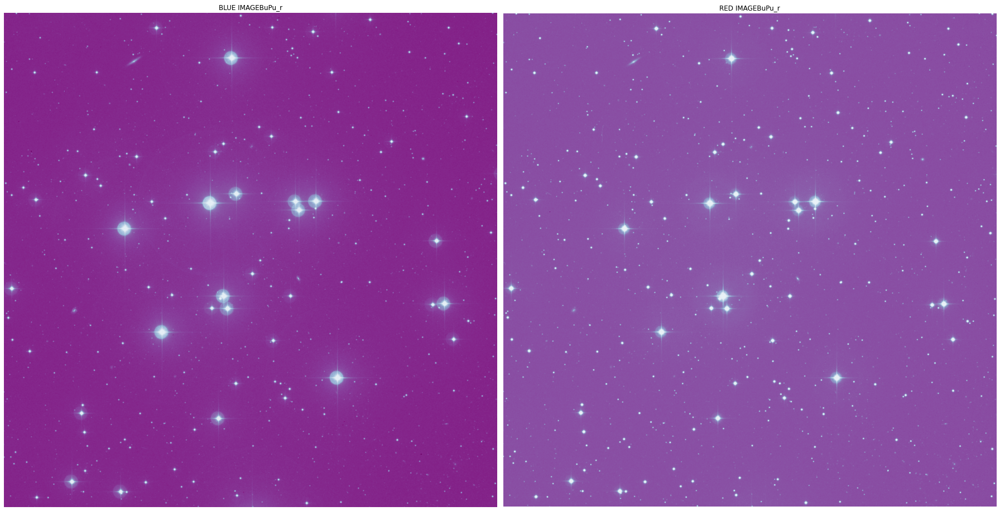

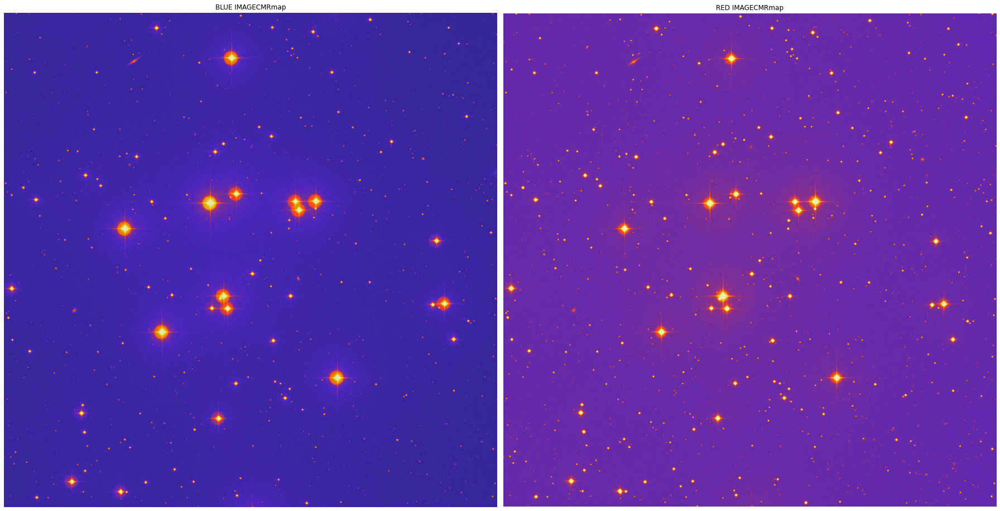

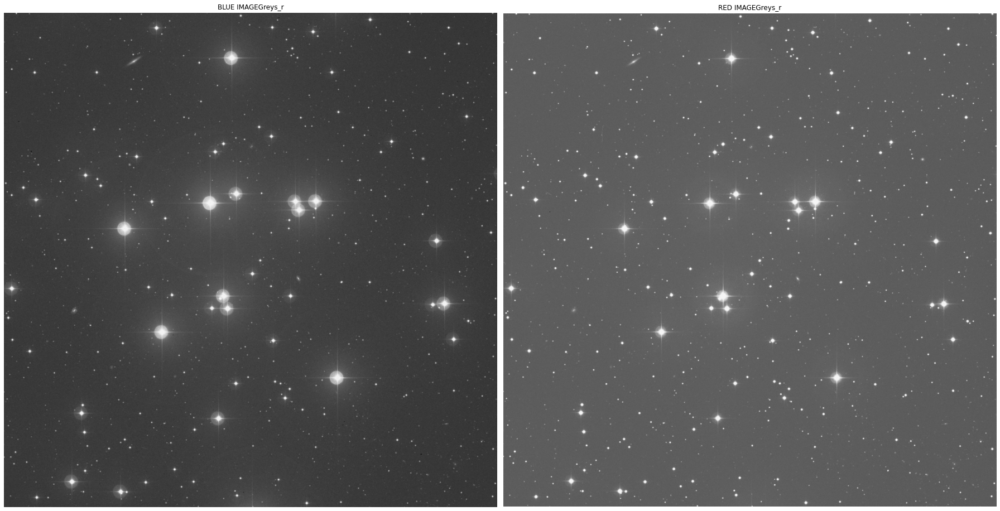

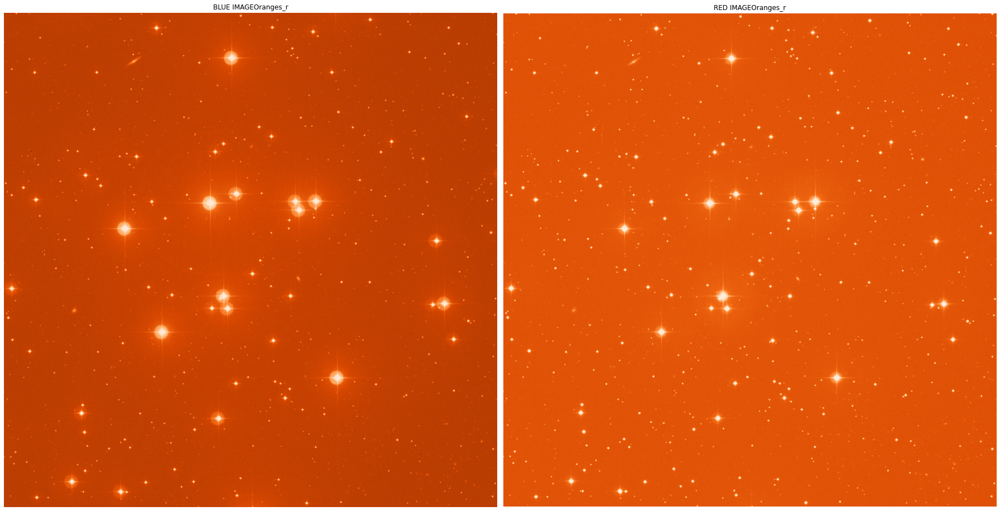

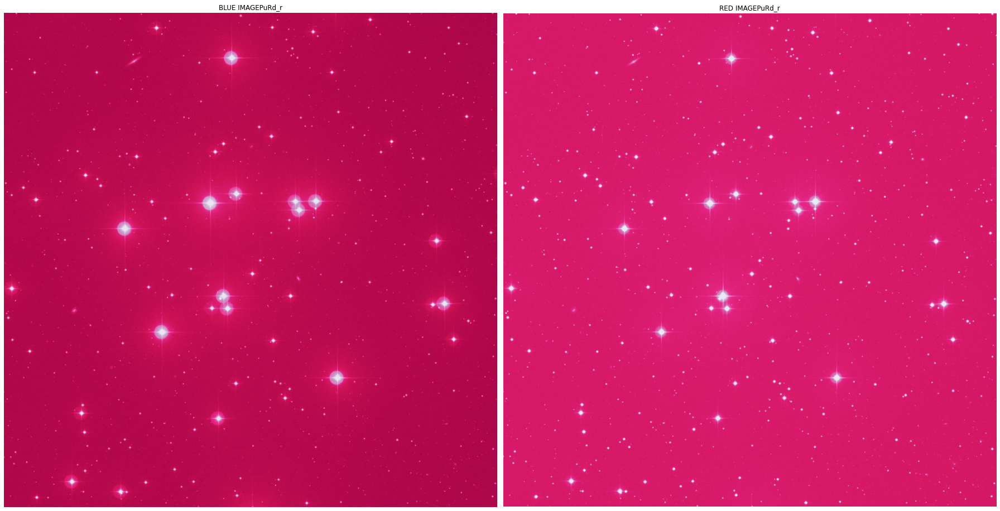

...

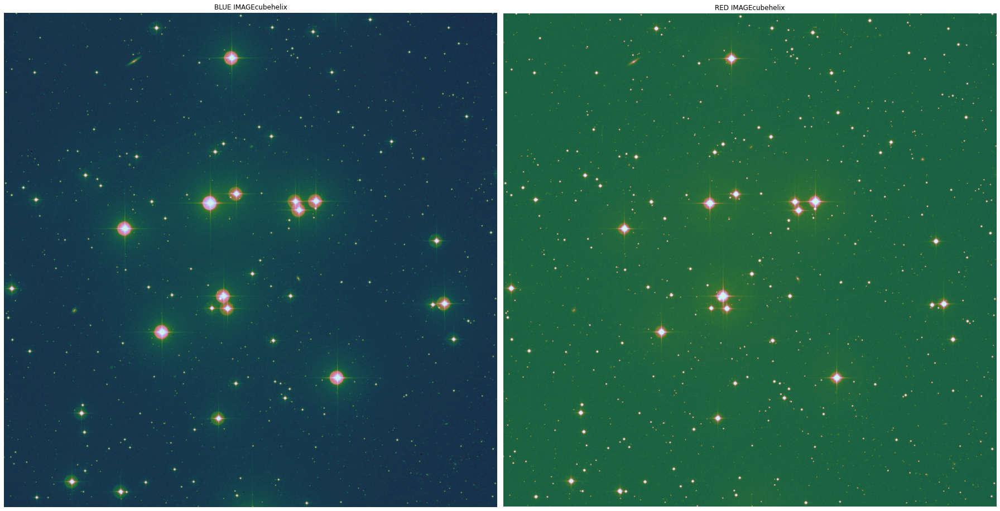

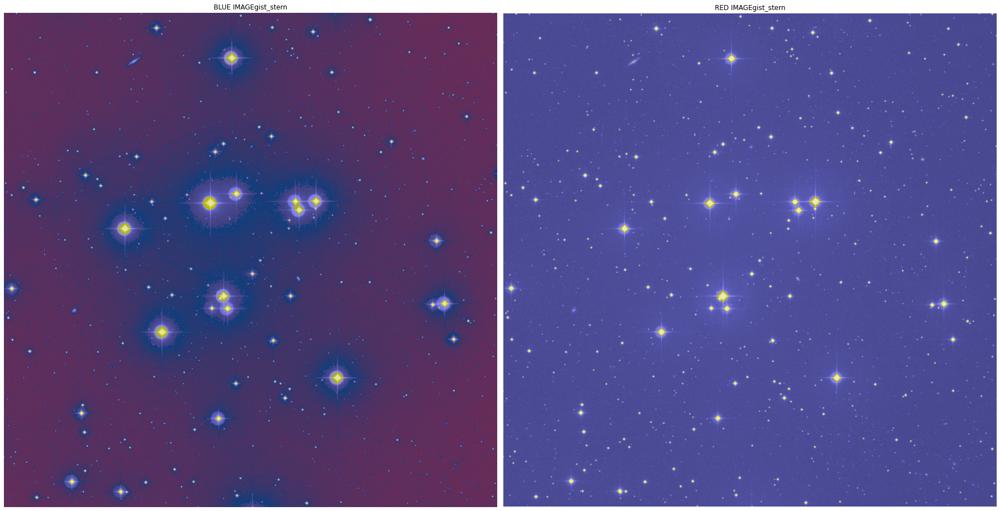

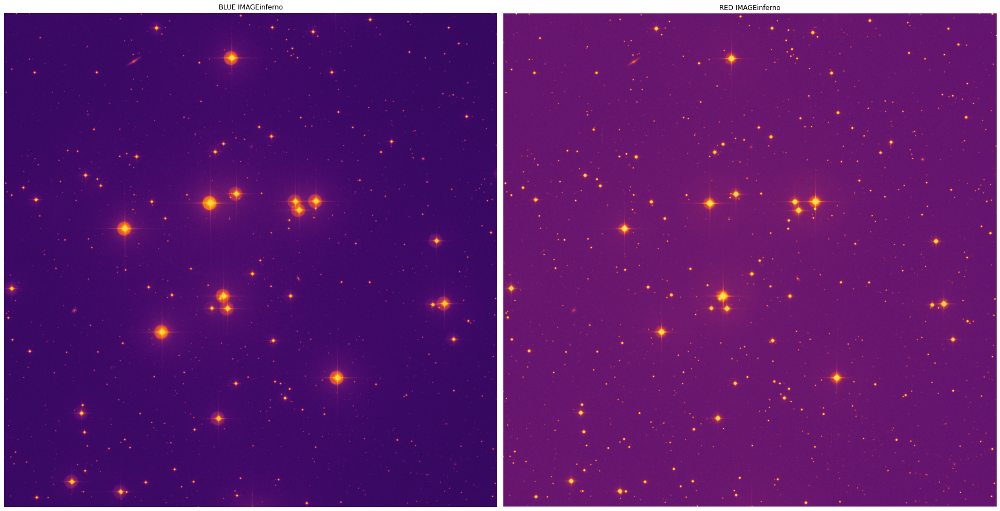

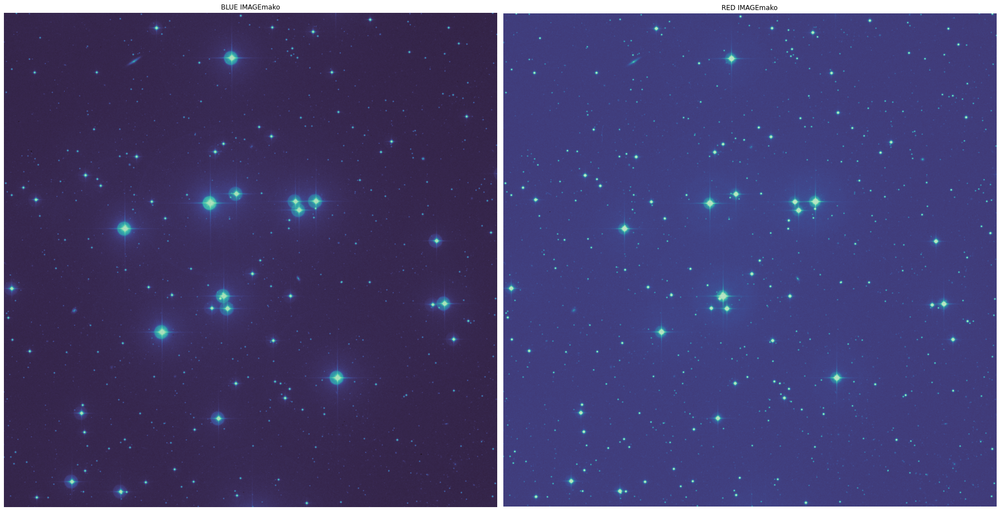

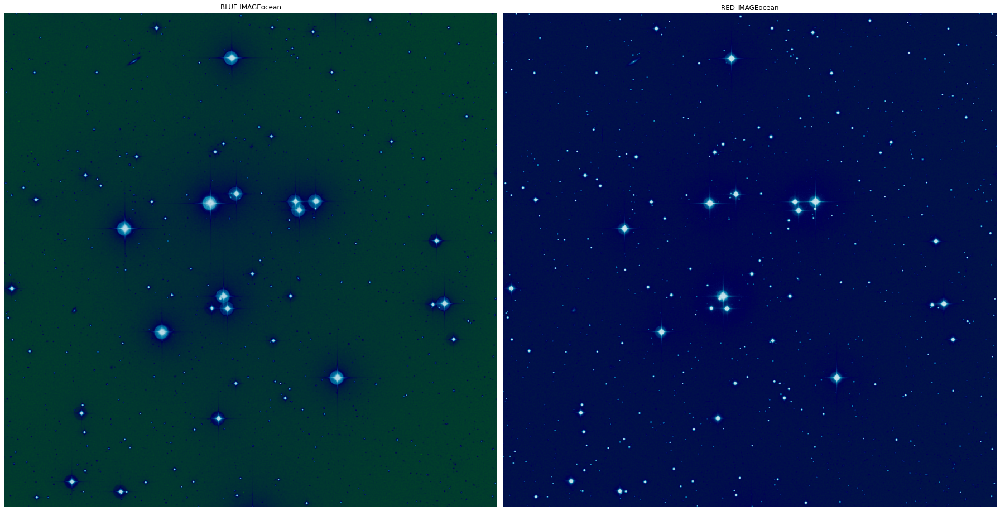

In [26]:
for x_spec in CMAP_LIST:
    
    figure,axis = plt.subplots(1,2,figsize=(25,25))
    
    axis[0].imshow(blue_IMAGE/ 255.,cmap=x_spec) 
    axis[0].set_title("BLUE IMAGE"+ x_spec)
    axis[0].axis("off")
    
    axis[1].imshow(red_IMAGE / 255.,cmap=x_spec)
    axis[1].set_title("RED IMAGE"+ x_spec)
    axis[1].axis("off")
    
        
    plt.tight_layout()
    plt.show()
    